## 基础作业2
[作业二说明](https://github.com/open-mmlab/OpenMMLabCamp/blob/main/AI%20%E5%AE%9E%E6%88%98%E8%90%A5%E5%9F%BA%E7%A1%80%E7%8F%AD/%E4%BD%9C%E4%B8%9A%E4%BA%8C_mmdetection.md)


## 1. 实例分割数据集Balloon

Balloon是带有mask的气球数据集可以用于实例分割等计算机视觉任务，

其中训练集包含61张图片，验证集包含13张图片。

下载链接：[Mask_RCNN balloon_dataset.zip matterport](https://link.zhihu.com/?target=https%3A//github.com/matterport/Mask_RCNN/releases/download/v2.1/balloon_dataset.zip)

训练集和测试集中分别有mask标注文件via_region_data.json


In [2]:
!tree data/balloon/

data/balloon/
├── train
│   ├── 10464445726_6f1e3bbe6a_k.jpg
│   ├── 12037308314_e16fb3a0f7_k.jpg
│   ├── 120853323_d4788431b9_b.jpg
│   ├── 12288043903_fe1ea17a4e_k.jpg
│   ├── 12288355124_5e340d3de3_k.jpg
│   ├── 12288446656_2c6a90e6f5_k.jpg
│   ├── 126700562_8e27720147_b.jpg
│   ├── 1297451346_5b92bdac08_b.jpg
│   ├── 14321263043_b76ef054d3_k.jpg
│   ├── 145053828_e0e748717c_b.jpg
│   ├── 14666848163_8be8e37562_k.jpg
│   ├── 15290896925_884ab33fd3_k.jpg
│   ├── 15331928994_d5b82eb368_k.jpg
│   ├── 154446334_5d41cd1375_b.jpg
│   ├── 155815494_800fc9aa32_b.jpg
│   ├── 15717689633_5f7f78c28e_k.jpg
│   ├── 16435593892_2aa8118f4a_k.jpg
│   ├── 17156759330_5af4f5a5b8_k.jpg
│   ├── 17178818589_16e58fc1e5_k.jpg
│   ├── 18849792632_aad23ad513_k.jpg
│   ├── 2311771643_f46392fcc0_b.jpg
│   ├── 2354829160_3f65a6bf6f_b.jpg
│   ├── 2385899600_94b68350af_b.jpg
│   ├── 24362039530_b151b41a52_k.jpg
│   ├── 25899693952_7c8b8b9edc_k.jpg
│   ├── 2685563244_b0d5f7eb67_b.jpg
│   ├── 2937599387_80e7d6e050

In [4]:
!cat data/balloon/train/via_region_data.json

{"34020010494_e5cb88e1c4_k.jpg1115004":{"fileref":"","size":1115004,"filename":"34020010494_e5cb88e1c4_k.jpg","base64_img_data":"","file_attributes":{},"regions":{"0":{"shape_attributes":{"name":"polygon","all_points_x":[1020,1000,994,1003,1023,1050,1089,1134,1190,1265,1321,1361,1403,1428,1442,1445,1441,1427,1400,1361,1316,1269,1228,1198,1207,1210,1190,1177,1172,1174,1170,1153,1127,1104,1061,1032,1020],"all_points_y":[963,899,841,787,738,700,663,638,621,619,643,672,720,765,800,860,896,942,990,1035,1079,1112,1129,1134,1144,1153,1166,1166,1150,1136,1129,1122,1112,1084,1037,989,963]},"region_attributes":{}}}},"25899693952_7c8b8b9edc_k.jpg814535":{"fileref":"","size":814535,"filename":"25899693952_7c8b8b9edc_k.jpg","base64_img_data":"","file_attributes":{},"regions":{"0":{"shape_attributes":{"name":"polygon","all_points_x":[586,510,441,389,331,268,196,158,135,156,210,307,403,437,443,425,448,481,506,513,503,511,502,583,669,755,800,811,803,784,755,717,668,620,586],"all_points_y":[133,116,115

# 实验环境创建和检查

In [1]:
# !pip install openmim
# !mim install mmdet

import torch
import mmcv
import mmdet

In [2]:
print(torch.__version__,mmcv.__version__,mmdet.__version__)

1.10.1+cu113 2.0.0rc3 3.0.0rc5


In [4]:
#　查看via_region_data.json结构和内容
!cat data/balloon/val/via_region_data.json

{"24631331976_defa3bb61f_k.jpg668058":{"fileref":"","size":668058,"filename":"24631331976_defa3bb61f_k.jpg","base64_img_data":"","file_attributes":{},"regions":{"0":{"shape_attributes":{"name":"polygon","all_points_x":[916,913,905,889,868,836,809,792,789,784,777,769,767,777,786,791,769,739,714,678,645,615,595,583,580,584,595,614,645,676,716,769,815,849,875,900,916,916],"all_points_y":[515,583,616,656,696,737,753,767,777,785,785,778,768,766,760,755,755,743,728,702,670,629,588,539,500,458,425,394,360,342,329,331,347,371,398,442,504,515]},"region_attributes":{}}}},"16335852991_f55de7958d_k.jpg1767935":{"fileref":"","size":1767935,"filename":"16335852991_f55de7958d_k.jpg","base64_img_data":"","file_attributes":{},"regions":{"0":{"shape_attributes":{"name":"polygon","all_points_x":[588,617,649,673,692,708,722,730,737,718,706,699,697,676,650,613,580,552,534,520,513,513,521,526,541,560,588],"all_points_y":[173,168,172,182,197,216,237,260,283,312,341,367,390,369,349,337,337,347,361,332,296,266

In [5]:
# generate coco format json
!python balloon2CoCoFormat3.py

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 61/61, 47.7 task/s, elapsed: 1s, ETA:     0s
[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 13/13, 45.4 task/s, elapsed: 0s, ETA:     0s


In [6]:
# 查看balloon2CoCoFormat3代码详情
!cat balloon2CoCoFormat3.py

import os.path as osp
import mmcv

from mmengine.fileio import dump, load
from mmengine.utils import track_iter_progress

# https://mmdetection.readthedocs.io/en/latest/2_new_data_model.html
# https://github.com/open-mmlab/mmdetection/blob/3.x/docs/en/user_guides/train.md
# https://blog.csdn.net/weixin_44966641/article/details/118686130
def convert_balloon_to_coco(ann_file, out_file, image_prefix):
    data_infos = load(ann_file)

    annotations = []
    images = []
    obj_count = 0
    for idx, v in enumerate(track_iter_progress(data_infos.values())):
        filename = v['filename']
        img_path = osp.join(image_prefix, filename)
        height, width = mmcv.imread(img_path).shape[:2]

        images.append(dict(
            id=idx,
            file_name=filename,
            height=height,
            width=width))

        for _, obj in v['regions'].items():
            assert not obj['region_attributes']
            obj = obj['shape_attributes']
            px = obj['all_poi

In [7]:
# 查看生成的coco格式的json文件
!cat data/balloon/val/val.json

{
    "images": [
        {
            "id": 0,
            "file_name": "24631331976_defa3bb61f_k.jpg",
            "height": 2048,
            "width": 1323
        },
        {
            "id": 1,
            "file_name": "16335852991_f55de7958d_k.jpg",
            "height": 2048,
            "width": 1536
        },
        {
            "id": 2,
            "file_name": "14898532020_ba6199dd22_k.jpg",
            "height": 1365,
            "width": 2048
        },
        {
            "id": 3,
            "file_name": "8053085540_a72bd21a64_k.jpg",
            "height": 1595,
            "width": 2048
        },
        {
            "id": 4,
            "file_name": "6810773040_3d81036d05_k.jpg",
            "height": 1536,
            "width": 2048
        },
        {
            "id": 5,
            "file_name": "5603212091_2dfe16ea72_b.jpg",
            "height": 1024,
            "width": 768
        },
        {
            "id": 6,
            "file_name": "5555705118_

# 下载原始配置文件

从 Model Zoo 中找到 mask rcnn 模型并找到 configs/mask_rcnn/ 中对应的模型配置文件。将模型下载到环境中，通常放在放置在 checkpoints 文件夹中。

或者使用mim search 命令

In [12]:
!mim search mmdet --model "mask r-cnn"

--------------------------------------------------------------------------------
config id: mask-rcnn_convnext-t-p4-w7_fpn_amp-ms-crop-3x_coco
architecture                                            convnext
coco/box_ap                                             46.2
coco/mask_ap                                            41.7
config                                                  configs/convnext/mask...
epochs                                                  36
model                                                   mask r-cnn
paper                                                   URL,Title
readme                                                  configs/mask_rcnn/REA...
training_data                                           coco
training_memory(GB)                                     7.3
training_resources                                      8x a100 gpus
training_techniques                                     adamw,mixed precision...
weight                                       

In [5]:
# download the pretrained model with smallest size
!mim download mmdet --config mask-rcnn_r50_fpn_2x_coco --dest .

processing mask-rcnn_r50_fpn_2x_coco...
mask_rcnn_r50_fpn_2x_coco_bbox_mAP-0.392__segm_mAP-0.354_20200505_003907-3e542a40.pth exists in /home/cine/mmcls1/mmdetection
Successfully dumped mask-rcnn_r50_fpn_2x_coco.py to /home/cine/mmcls1/mmdetection


In [3]:
# Test model before retraining
from mmdet.apis import init_detector,inference_detector # ,show_result_pyplot
from mmdet.utils import register_all_modules

config_file = 'mask-rcnn_r50_fpn_2x_coco.py'
checkpoint_file = 'mask_rcnn_r50_fpn_2x_coco_bbox_mAP-0.392__segm_mAP-0.354_20200505_003907-3e542a40.pth'
register_all_modules()
model0 = init_detector(config_file,checkpoint_file,device='cpu')

02/16 04:59:26 - mmengine - WARNING - The "model" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/16 04:59:27 - mmengine - WARNING - The "task util" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
Loads checkpoint by local backend from path: mask_rcnn_r50_fpn_2x_coco_bbox_mAP-0.392__segm_mAP-0.354_20200505_003907-3e542a40.pth
02/16 04:59:27 - mmengine - WARNING - The "dataset" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/16 04:59:27 - mmengine - WARNING - The "transform" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.


In [4]:
from mmdet.registry import VISUALIZERS

# init the visualizer(execute this block only once)
visualizer = VISUALIZERS.build(model0.cfg.visualizer)
# the dataset_meta is loaded from the checkpoint and
# then pass to the model in init_detector
visualizer.dataset_meta = model0.dataset_meta

02/16 04:59:27 - mmengine - WARNING - The "visualizer" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.


/home/cine/miniconda3/envs/mmlab2/lib/python3.8/site-packages/mmengine/visualization/visualizer.py:163: UserWarning: `Visualizer` backend is not initialized because save_dir is None.
  warnings.warn('`Visualizer` backend is not initialized '


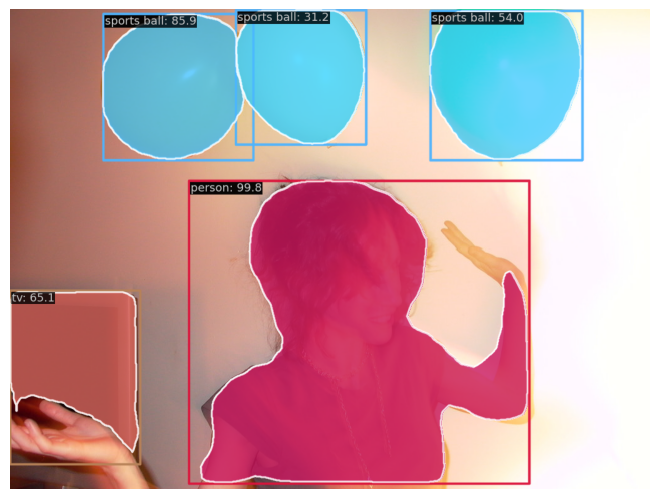

In [15]:
image_path = './data/balloon/val/410488422_5f8991f26e_b.jpg'

img = mmcv.imread( image_path, channel_order='rgb')
result = inference_detector(model0,img)

# show the results
visualizer.add_datasample(
    'result',
    img,
    data_sample=result,
    draw_gt=False,
    wait_time=0,
)
visualizer.show()

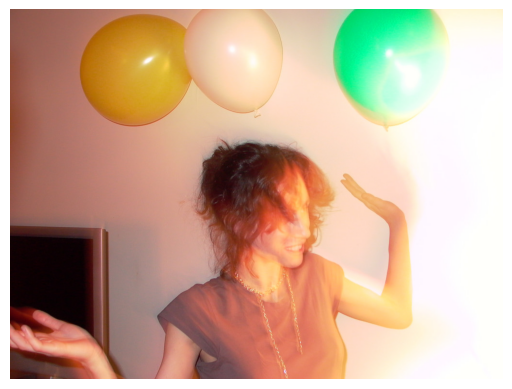

In [6]:
# 原图
import matplotlib.pyplot as plt
plt.imshow(img)
plt.axis('off')
plt.show()

这里放一下原图我们比较一下，可以看出，预训练模型的效果还是不太好的

# 修改config

In [7]:
!cat mask-rcnn_r50_fpn_2x_coco.py

model = dict(
    type='MaskRCNN',
    data_preprocessor=dict(
        type='DetDataPreprocessor',
        mean=[123.675, 116.28, 103.53],
        std=[58.395, 57.12, 57.375],
        bgr_to_rgb=True,
        pad_mask=True,
        pad_size_divisor=32),
    backbone=dict(
        type='ResNet',
        depth=50,
        num_stages=4,
        out_indices=(0, 1, 2, 3),
        frozen_stages=1,
        norm_cfg=dict(type='BN', requires_grad=True),
        norm_eval=True,
        style='pytorch',
        init_cfg=dict(type='Pretrained', checkpoint='torchvision://resnet50')),
    neck=dict(
        type='FPN',
        in_channels=[256, 512, 1024, 2048],
        out_channels=256,
        num_outs=5),
    rpn_head=dict(
        type='RPNHead',
        in_channels=256,
        feat_channels=256,
        anchor_generator=dict(
            type='AnchorGenerator',
            scales=[8],
            ratios=[0.5, 1.0, 2.0],
            strides=[4, 8, 16, 32, 64]),
        bbox_coder=dict(
        

## 改配置文件(含新数据集的注册)
第二步需要准备一个配置文件来成功加载数据集。
假设我们想要用 balloon dataset 来训练配备了 FPN 的 Mask R-CNN ，如下是我们的配置文件。
配置文件命名为 mask-rcnn_r50-caffe_fpn_ms-poly-1x_balloon3_new.py，
可以保存路径为 configs/balloon/，或者根据自己习惯任意放置，为了方便查看我们把他放在主目录下，配置文件内容如下所示。

# Config修改重点

    主要修改点1：修改model.[backbone, bbox_head, mask_head]

model.[bbox_head,mask_head].num_classes=1, model.backbone.init_cfg=None

    model的bbox_head和mask_head的num_classes，只有一个balloon类，因此修改为num_classes=1

    主要修改点2：数据集注册  with train_dataloader.dataset.metainfo.classes,
```
# dataset settings
data_root = 'data/balloon/'

train_dataloader = dict(
    dataset=dict(
        data_root=data_root,
        ann_file='train/train.json',
        data_prefix=dict(img='train/')))
```
    主要修改点3：在dataset/dataloader中，dataroot是可以和ann_file,data_prefix相连的，在项目中，json文件的目录为：'data/balloon/train/train.json'
```
val_evaluator = dict(
    type='CocoMetric',
    ann_file='data/balloon/val/val.json',
    metric=['bbox', 'segm'],
    format_only=False)
test_evaluator = val_evaluator
```
    主要修改点4：evaluator中的type要和dataset_type对应，ann_file写完整的路径，metric要写['bbox', 'segm'], 当我们的数据没有标注只有类别class时，metric可以用mAP
```
# training schedule for 2x
train_cfg = dict(type='EpochBasedTrainLoop', max_epochs=24, val_interval=3)

# Default setting for scaling LR automatically
#   - `enable` means enable scaling LR automatically
#       or not by default.
#   - `base_batch_size` = (8 GPUs) x (2 samples per GPU).
auto_scale_lr = dict(enable=False, base_batch_size=2)

# learning rate
param_scheduler = [dict(type='LinearLR'),dict(type='MultiStepLR')]

# optimizer
optim_wrapper = dict(optimizer=dict(type='SGD', lr=0.002, momentum=0.9, weight_decay=0.0001))

default_hooks = dict(
    logger=dict(type='LoggerHook', interval=3),,
    checkpoint=dict(type='CheckpointHook', interval=3)

log_level = 'INFO'
load_from = 'mask_rcnn_r50_fpn_2x_coco_bbox_mAP-0.392__segm_mAP-0.354_20200505_003907-3e542a40.pth'
```
    主要修改点5：2x: For1x/2x, the initial learning rate decays by a factor of 10 at the 8/16th and 11/22th epochs.
    主要修改点6：几个interval，如train_cfg.val_interval, default_hooks.logger.interval, default_hooks.CheckpointHook.interval
    主要修改点7：optimizer :optim_wrapper = dict(optimizer=dict(type='SGD', lr=0.002, momentum=0.9, weight_decay=0.0001))


由于新配置继承了`_base_`基本配置，所以我们只做必要的修改即可

In [13]:
!cat mask-rcnn_r50_fpn_2x_coco_balloon3_new.py

# 新配置继承了基本配置，并做了必要的修改
# _base_ = '../mask_rcnn/mask-rcnn_r50_fpn_2x_coco.py'
_base_ = 'configs/mask_rcnn/mask-rcnn_r50_fpn_2x_coco.py'

# 我们还需要更改 head 中的 num_classes 以匹配数据集中的类别数
model = dict(
    roi_head=dict(
        bbox_head=dict(num_classes=1),
        mask_head=dict(num_classes=1)))

# 修改数据集相关配置
data_root = 'data/balloon/'
metainfo = {
    'classes': ('balloon', ),
    'palette': [
        (220, 20, 60),
    ]
}
train_dataloader = dict(
    batch_size=1,
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        ann_file='train/train.json',
        data_prefix=dict(img='train/')))
val_dataloader = dict(
    dataset=dict(
        data_root=data_root,
        metainfo=metainfo,
        ann_file='val/val.json',
        data_prefix=dict(img='val/')))
test_dataloader = val_dataloader

# 修改评价指标相关配置
val_evaluator = dict(ann_file=data_root + 'val/val.json')
test_evaluator = val_evaluator

# 使用预训练的 Mask R-CNN 模型权重来做初始化，可以提高模型性能
load_from = 'mask_rcnn_r50_fpn_2x_coco

我们也是可以使用预训练模型进行批量测试的，

In [21]:
# 训练前使用预训练的权重批量测试
!python tools/test.py mask-rcnn_r50_fpn_2x_coco_balloon3_new.py \
    mask_rcnn_r50_fpn_2x_coco_bbox_mAP-0.392__segm_mAP-0.354_20200505_003907-3e542a40.pth \
    --show-dir show_before_train_gt


02/16 05:20:29 - mmengine - WARNING - The "log_processor" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/16 05:20:30 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.8.16 (default, Jan 17 2023, 23:13:24) [GCC 11.2.0]
    CUDA available: True
    numpy_random_seed: 1741128465
    GPU 0: NVIDIA GeForce GTX 1080 Ti
    CUDA_HOME: /home/cine/miniconda3/envs/mmlab2
    NVCC: Cuda compilation tools, release 11.6, V11.6.124
    GCC: gcc (Ubuntu 11.3.0-1ubuntu1~22.04) 11.3.0
    PyTorch: 1.10.1+cu113
    PyTorch compiling details: PyTorch built with:
  - GCC 7.3
  - C++ Version: 201402
  - Intel(R) oneAPI Math Kernel Library Version 2021.4-Product Build 20210904 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.2.3 (Git Hash 7336ca9f055cf1bfa13efb658fe15dc9b41f0740)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled 

In [ ]:
# 很差的结果
# coco/bbox_mAP: 0.0080  coco/bbox_mAP_50: 0.0320  coco/bbox_mAP_75: 0.0010
# coco/bbox_mAP_s: 0.0000  coco/bbox_mAP_m: 0.0040  coco/bbox_mAP_l: 0.0140
#
# coco/segm_mAP: 0.0270  coco/segm_mAP_50: 0.0550  coco/segm_mAP_75: 0.0230
# coco/segm_mAP_s: 0.0010  coco/segm_mAP_m: 0.0120  coco/segm_mAP_l: 0.1000

我还写了一个批量可视化所有测试结果的代码，大家可以借鉴一下。(这里用的图片mmdet2.x训练成功后的预测图片，不带ground truth)

In [1]:
# generate visualization with test results for test images
import matplotlib.pyplot as plt
import os
import cv2

path_name = r'work_dirs/mask-rcnn_r50_fpn_2x_coco_balloon3_new/20230216_050210/show_before_train_gt'
num = 1

# plt.rcParams['figure.dpi'] = 300
plt.figure(figsize=(20,12),dpi=300)
for item in os.listdir(path=path_name):
    img = cv2.imread(os.path.join(path_name,item))[:,:, ::-1]
    # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(3,5,num)
    num+=1
    plt.imshow(img)
    plt.title(item)
    plt.xticks([])
    plt.yticks([])
    # break
plt.show()

# 模型训练

In [30]:
!python tools/train.py \
    mask-rcnn_r50_fpn_2x_coco_balloon3_new.py \
    --work-dir work_dirs/mask-rcnn_r50_fpn_2x_coco_balloon3_new/

02/16 05:58:07 - mmengine - WARNING - The "log_processor" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/16 05:58:07 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.8.16 (default, Jan 17 2023, 23:13:24) [GCC 11.2.0]
    CUDA available: True
    numpy_random_seed: 494326966
    GPU 0: NVIDIA GeForce GTX 1080 Ti
    CUDA_HOME: /home/cine/miniconda3/envs/mmlab2
    NVCC: Cuda compilation tools, release 11.6, V11.6.124
    GCC: gcc (Ubuntu 11.3.0-1ubuntu1~22.04) 11.3.0
    PyTorch: 1.10.1+cu113
    PyTorch compiling details: PyTorch built with:
  - GCC 7.3
  - C++ Version: 201402
  - Intel(R) oneAPI Math Kernel Library Version 2021.4-Product Build 20210904 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.2.3 (Git Hash 7336ca9f055cf1bfa13efb658fe15dc9b41f0740)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled (

#### 训练结果
```
coco/bbox_mAP: 0.7160  coco/bbox_mAP_50: 0.8320  coco/bbox_mAP_75: 0.8150
coco/bbox_mAP_s: 0.0000  coco/bbox_mAP_m: 0.4730  coco/bbox_mAP_l: 0.7950
coco/segm_mAP: 0.7370  coco/segm_mAP_50: 0.8130  coco/segm_mAP_75: 0.8130
coco/segm_mAP_s: 0.0000  coco/segm_mAP_m: 0.4460  coco/segm_mAP_l: 0.8270
```

模型对小物体的预测不太好，但是对大气球预测效果较好，s,m,l：small，middle, large
整体效果在可接受范围之内

# 测试以及推理
使用训练好的模型对测试集进行测试

Loads checkpoint by local backend from path: work_dirs/mask-rcnn_r50_fpn_2x_coco_balloon3_new/epoch_24.pth


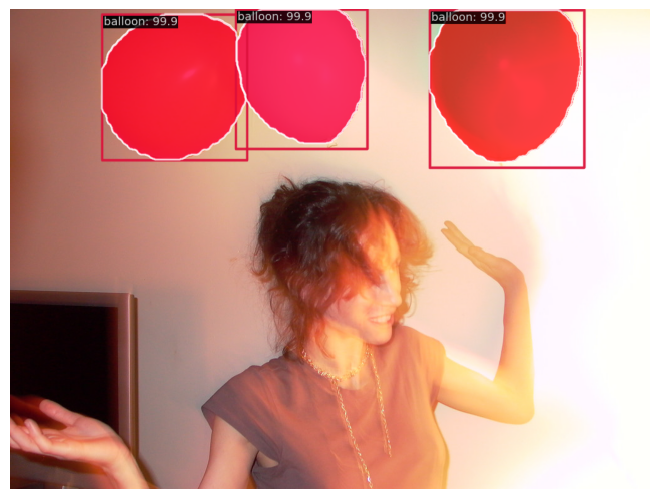

In [43]:
config_file_retrain = 'mask-rcnn_r50_fpn_2x_coco_balloon3_new.py'
checkpoint_file_retrain = 'work_dirs/mask-rcnn_r50_fpn_2x_coco_balloon3_new/epoch_24.pth'

model = init_detector(config_file_retrain,checkpoint_file_retrain,device='cpu')

result_retrain = inference_detector(model,img)
visualizer.dataset_meta = model.dataset_meta   # set the visualizer metadata when you changed your dataset

# show the results
visualizer.add_datasample(
    'result',
    img,
    data_sample=result_retrain,
    draw_gt=False,
    wait_time=0,
)
visualizer.show()


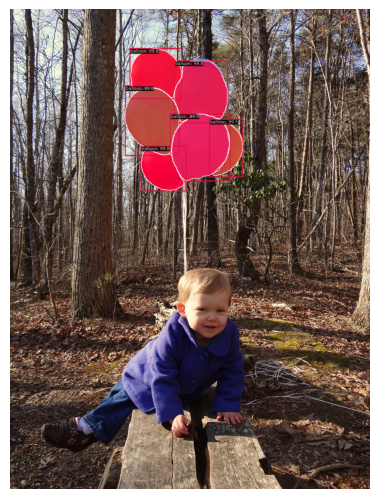

In [32]:
image_path2 = 'data/balloon/val/16335852991_f55de7958d_k.jpg'
img2 = mmcv.imread( image_path2, channel_order='rgb')
result_retrain2 = inference_detector(model,img2)

# show the results
visualizer.add_datasample(
    'result',
    img2,
    data_sample=result_retrain2,
    draw_gt=False,
    wait_time=0,
)
visualizer.show()

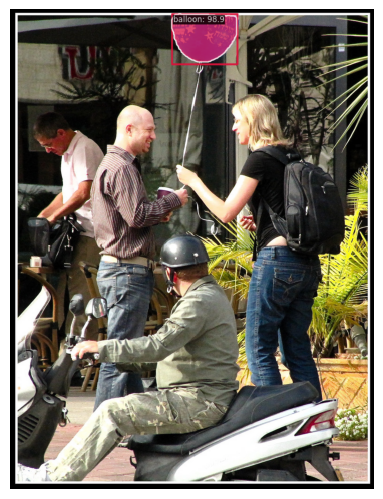

In [33]:
image_path2 = 'data/balloon/val/4581425993_72b9b15fc0_b.jpg'

img2 = mmcv.imread( image_path2, channel_order='rgb')
result_retrain2 = inference_detector(model,img2)

# show the results
visualizer.add_datasample(
    'result',
    img2,
    data_sample=result_retrain2,
    draw_gt=False,
    wait_time=0,
)
visualizer.show()

# 查看result_retrain
打印result_retrain,查看训练结果的数据构造

In [44]:
result_retrain

<DetDataSample(

    META INFORMATION
    img_id: 0
    img_path: None
    batch_input_shape: (800, 1088)
    img_shape: (800, 1067)
    scale_factor: (1.0419921875, 1.0416666666666667)
    ori_shape: (768, 1024)
    pad_shape: (800, 1088)

    DATA FIELDS
    ignored_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            labels: tensor([], dtype=torch.int64)
            masks: BitmapMasks(num_masks=0, height=768, width=1024)
            bboxes: tensor([], size=(0, 4))
        ) at 0x7ff880ebee20>
    gt_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            labels: tensor([], dtype=torch.int64)
            masks: BitmapMasks(num_masks=0, height=768, width=1024)
            bboxes: tensor([], size=(0, 4))
        ) at 0x7ff880ebe940>
    pred_instances: <InstanceData(
        
            META INFORMATION
        
            DATA FIELDS
            masks: tensor([[[False, False,

In [45]:
print(type(result_retrain),'\n',result_retrain.keys())

<class 'mmdet.structures.det_data_sample.DetDataSample'> 
 ['ignored_instances', 'gt_instances', 'pred_instances']


In [46]:
result_retrain.gt_instances.keys()

['labels', 'masks', 'bboxes']

In [47]:
result_retrain.ignored_instances.keys()

['labels', 'masks', 'bboxes']

In [48]:
result_retrain.pred_instances.keys()

['masks', 'scores', 'labels', 'bboxes']

In [49]:
for i in result_retrain.pred_instances.keys():
    print(i,result_retrain.pred_instances[i].shape)
    print(result_retrain.pred_instances[i][:1])
    print()

masks torch.Size([3, 768, 1024])
tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]]])

scores torch.Size([3])
tensor([0.9994])

labels torch.Size([3])
tensor([0])

bboxes torch.Size([3, 4])
tensor([[146.6895,   9.7411, 379.3868, 243.3389]])



In [50]:
for i in result_retrain.pred_instances.keys():
    print(i,result_retrain.pred_instances[i].shape)
    # print(result_retrain.pred_instances[i][:1])
    print()

masks torch.Size([3, 768, 1024])

scores torch.Size([3])

labels torch.Size([3])

bboxes torch.Size([3, 4])



In [51]:
for i in result_retrain.gt_instances.keys():
    print(i,result_retrain.pred_instances[i].shape)
    print(result_retrain.pred_instances[i][:1])
    print()

labels torch.Size([3])
tensor([0])

masks torch.Size([3, 768, 1024])
tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]]])

bboxes torch.Size([3, 4])
tensor([[146.6895,   9.7411, 379.3868, 243.3389]])



In [52]:
result.pred_instances.scores.numpy()

array([0.99838305, 0.85916036, 0.65062916, 0.5403771 , 0.31220037,
       0.18796745, 0.10219406, 0.09249002, 0.08700147, 0.07086968,
       0.06580309, 0.06291567], dtype=float32)

In [53]:
result.pred_instances.scores[0]

tensor(0.9984)

In [55]:
# generate test results for test images
!python tools/test.py \
    mask-rcnn_r50_fpn_2x_coco_balloon3_new.py \
    work_dirs/mask-rcnn_r50_fpn_2x_coco_balloon3_new/epoch_24.pth \
    --show-dir show

02/16 06:15:58 - mmengine - WARNING - The "log_processor" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/16 06:15:59 - mmengine - INFO - 
------------------------------------------------------------
System environment:
    sys.platform: linux
    Python: 3.8.16 (default, Jan 17 2023, 23:13:24) [GCC 11.2.0]
    CUDA available: True
    numpy_random_seed: 1092237040
    GPU 0: NVIDIA GeForce GTX 1080 Ti
    CUDA_HOME: /home/cine/miniconda3/envs/mmlab2
    NVCC: Cuda compilation tools, release 11.6, V11.6.124
    GCC: gcc (Ubuntu 11.3.0-1ubuntu1~22.04) 11.3.0
    PyTorch: 1.10.1+cu113
    PyTorch compiling details: PyTorch built with:
  - GCC 7.3
  - C++ Version: 201402
  - Intel(R) oneAPI Math Kernel Library Version 2021.4-Product Build 20210904 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v2.2.3 (Git Hash 7336ca9f055cf1bfa13efb658fe15dc9b41f0740)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - LAPACK is enabled 

In [2]:
# generate visualization with test results for test images
import matplotlib.pyplot as plt
import os
import cv2

path_name = r'work_dirs/mask-rcnn_r50_fpn_2x_coco_balloon3_new/20230216_061558/show'
num = 1

# plt.rcParams['figure.dpi'] = 300
plt.figure(figsize=(25,35),dpi=300)
for item in os.listdir(path=path_name):
    img = cv2.imread(os.path.join(path_name,item))[:,:, ::-1]
    # img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(7,2,num)
    num+=1
    plt.imshow(img)
    plt.title(item)
    plt.xticks([])
    plt.yticks([])
    # break
plt.savefig("work_dirs/mask-rcnn_r50_fpn_2x_coco_balloon3_new/20230216_061558/result7x2_25_35.png")
plt.show()


# Color splash特效制作
在获取到图像的mask之后，请同学们将图像转为灰度图像，并在mask区域将原图像的像素值拷贝到灰度图像上即可完成特效制作。
测试样例视频

☆视频读写

    代码采用MMDET inference中的mmcv的VideoReader读取视频
    读取标准为fourcc = cv2.VideoWriter_fourcc(*'mp4v'))
    用mmengine 的track_iter_progress方法逐帧从视频中抽出图像做图片检测，进行实例分割，预测气球的mask，并进行图像处理，
    最后将每一帧处理好的图片拼接好，使用cv2.VideoWriter还原成视频。

☆color splash
采用对于每帧视频，制作灰度背景和保留检测到的彩色气球时，

    首先将每帧视频的图片（三维矩阵）分解开BGR（mmcv使用OpenCV的api，不是RGB顺序）三个通道（每一个通道可以看为一个二维矩阵）
    将每一个通道的二维矩阵数据和预测的mask（也是二维矩阵）做元素对应相乘，然后再重新拼接成一个三通道的三维矩阵，得到一个三维的BGR的mask数据，完成对检测出的气球像素进行提取。
    然后un_mask = 1 - mask就可以得到非掩码部分，再进行相同处理，就可以完成对背景像素进行提取，并使用bgr2grey方法转换为灰度值，然后两者相加就是一个color splash的图片，这就是视频里抽取的该帧图片对应的处理好的帧图像.

In [58]:
!cat video3.py

import argparse
import numpy as np
import cv2
import mmcv

from mmdet.apis import inference_detector, init_detector
from mmdet.registry import VISUALIZERS

from mmdet.utils import register_all_modules
from mmengine import track_iter_progress


# 　https://mmdetection.readthedocs.io/en/3.x/user_guides/inference.html
#   https://github.com/open-mmlab/mmcv/blob/master/mmcv/video/io.py
def parse_args():
    parser = argparse.ArgumentParser(description='MMDetection balloon color splash video demo')
    parser.add_argument('video_path', help='path of video file ')
    parser.add_argument('model_config', help='path of config file ')
    parser.add_argument('checkpoint_path', help='path of fine-tuned checkpoint file')
    parser.add_argument(
        '--device', default='cuda:0', help='Device used for inference')
    parser.add_argument(
        '--score_thr', type=float, default=0.8, help='Bbox score threshold')
    parser.add_argument('--output_path', type=str, help='path of processed video f

In [60]:
# generate result.mp4 with trained model and test_video.mp4
!python video3.py \
    --output_path result.mp4 \
    test_video.mp4 \
    mask-rcnn_r50_fpn_2x_coco_balloon3_new.py \
    work_dirs/mask-rcnn_r50_fpn_2x_coco_balloon3_new/epoch_24.pth
    # --output_path2 test_video_gt.mp4 \

02/16 06:23:57 - mmengine - WARNING - The "model" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/16 06:23:57 - mmengine - WARNING - The "task util" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
Loads checkpoint by local backend from path: work_dirs/mask-rcnn_r50_fpn_2x_coco_balloon3_new/epoch_24.pth
02/16 06:23:57 - mmengine - WARNING - The "dataset" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/16 06:23:57 - mmengine - WARNING - The "transform" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
02/16 06:24:00 - mmengine - WARNING - The "visualizer" registry in mmdet did not set import location. Fallback to call `mmdet.utils.register_all_modules` instead.
/home/cine/miniconda3/envs/mmlab2/lib/python3.8/site-packages/mmengine/visualization/vis

 # generate gif with mp4 video

In [ ]:
# # to show the results, convert the mp4 to gif
# !pip install moviepy
# !pip install ez_setup

In [78]:
# from moviepy.editor import VideoFileClip
# videoClip = VideoFileClip("result.mp4")
# videoClip.write_gif("result.gif")   # 150M too big
#
# # since the generated gif is too big, I use online website to convert the mp4 videos to gifs.
# # MoviePy - Building file result.gif with imageio.

MoviePy - Building file result.gif with imageio.


# Several methods for mp4 displaying

In [61]:
# this works but open the video outside

import cv2
import numpy as np

# Create a VideoCapture object and read from input file
# If the input is the camera, pass 0 instead of the video file name
cap = cv2.VideoCapture('result.mp4')

# Check if camera opened successfully
if (cap.isOpened()== False):
  print("Error opening video stream or file")

# Read until video is completed
while(cap.isOpened()):
  # Capture frame-by-frame
  ret, frame = cap.read()
  if ret == True:

    # Display the resulting frame
    cv2.imshow('Frame',frame)

    # Press Q on keyboard to  exit
    if cv2.waitKey(25) & 0xFF == ord('q'):
      break

  # Break the loop
  else:
    break

# When everything done, release the video capture object
cap.release()

# Closes all the frames
cv2.destroyAllWindows()

In [62]:
from IPython.display import Video
Video('result.mp4')

In [63]:
from IPython.display import HTML

HTML("""
    <video alt="test" controls>
        <source src="result.mp4" type="video/mp4">
    </video>
""")

In [64]:
from IPython.display import HTML
from base64 import b64encode

def play(filename):
    html = ''
    video = open(filename,'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=1000 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src
    return HTML(html)

play('result.mp4')